In [2]:
pip install sktime

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.1/17.1 MB 30.1 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 118.2/118.2 kB 27.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.3/78.3 kB 23.3 MB/s eta 0:00:00
Note: you may need to restart the kernel to use updated packages.


In [3]:
pip install xgboost==1.2.1

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 148.9/148.9 MB 8.6 MB/s eta 0:00:0000:0100:01
Note: you may need to restart the kernel to use updated packages.


In [1]:
import os
import torch
import sys
import sktime
import tqdm as tq
import xgboost as xgb
import matplotlib
import seaborn as sns
import sklearn as skl
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from tqdm import tqdm
from sktime.forecasting.model_selection import temporal_train_test_split
from sktime.utils.plotting import plot_series
from xgboost import XGBRegressor

pd.set_option('display.max_columns', 30)

c:\Users\User\anaconda3\lib\site-packages\xgboost\compat.py:93: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  from pandas import MultiIndex, Int64Index


GPU 포트 바꾸기

In [6]:
os.environ["CUDA_DEVICE_ORDER"] = "PCI_BUS_ID"
os.environ["CUDA_VISIBLE_DEVICES"] = "1"
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

print('device :', device)
print('Current :', torch.cuda.current_device())
print('Count :', torch.cuda.device_count())

device : cuda
Current : 0
Count : 1


In [72]:
# 전처리 한 파일 불러오기
train = pd.read_csv('./data/processing/train_preprocessed.csv', index_col=0)
train.head()

,num,date_time,temp,prec,wind,hum,power,day,month,week,day_hour_mean,hour_mean,hour_std,holiday,sin_time,cos_time,THI,CDH
0,1,20220601 00,18.6,0.0,0.9,42.0,1085.28,2,6,22,1774.744615,1706.318118,446.882767,0,0.000000,1.000000,49.6576,-7.4
1,1,20220601 01,18.0,0.0,1.1,45.0,1047.36,2,6,22,1687.347692,1622.620235,439.662704,0,0.258819,0.965926,47.7625,-15.4
2,1,20220601 02,17.7,0.0,1.5,45.0,974.88,2,6,22,1571.483077,1506.971294,412.071906,0,0.500000,0.866025,47.2225,-23.7
3,1,20220601 03,16.7,0.0,1.4,48.0,953.76,2,6,22,1522.153846,1437.365647,391.205981,0,0.707107,0.707107,44.7856,-33.0
4,1,20220601 04,18.4,0.0,2.8,43.0,986.40,2,6,22,1506.793846,1447.321412,381.099697,0,0.866025,0.500000,49.0061,-40.6


train data shape
x:(1872, 15), y:(1872,)


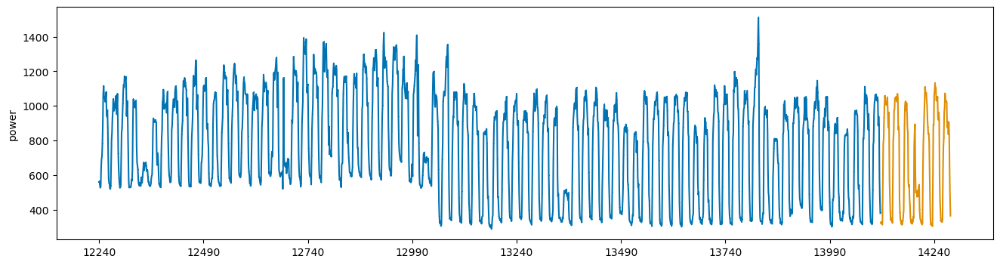

In [3]:
## 7번 건물의 발전량
## 마지막 일주일 발전량을 validset으로
y = train.loc[train.num == 7, 'power']
x = train.loc[train.num == 7, ].iloc[:, 3:]

y_train, y_valid, x_train, x_valid = temporal_train_test_split(y = y, X = x, test_size = 168) # 24시간*7일 = 168

print('train data shape\nx:{}, y:{}'.format(x_train.shape, y_train.shape))

plot_series(y_train, y_valid, markers=[',' , ','])
plt.show()

## model tuning

평가 Metric SMAPE은 과소적합보다 과대적합이 더 좋은 점수를 띔

In [4]:
# Define SMAPE loss function
def SMAPE(true, pred):
    return np.mean((np.abs(true-pred))/(np.abs(true) + np.abs(pred))) * 100

In [5]:
print("실제값이 100일 때 50으로 underestimate할 때의 SMAPE : {}".format(SMAPE(100, 50)))
print("실제값이 100일 때 150으로 overestimate할 때의 SMAPE : {}".format(SMAPE(100, 150)))

실제값이 100일 때 50으로 underestimate할 때의 SMAPE : 33.33333333333333
실제값이 100일 때 150으로 overestimate할 때의 SMAPE : 20.0


#### 그러나 일반 mse를 objective function으로 훈련할 때 과소추정하는 건물들이 있음을 확인했습니다.
#### 이때문에 SMAPE 점수가 높아진다고 판단, 이를 해결하기 위해 아래와 같이 objective function을 새로 정의했습니다.
#### 새 목적함수는 residual이 0보다 클 때, 즉 실제값보다 낮게 추정할 때 alpha만큼의 가중치를 곱해 반영합니다.

#### XGBoost는 custom objective function으로 훈련하기 위해선 아래와 같이
#### gradient(1차 미분함수) / hessian(2차 미분함수)를 정의해 두 값을 return해주어야 합니다.

In [6]:
#### alpha를 argument로 받는 함수로 실제 objective function을 wrapping하여 alpha값을 쉽게 조정할 수 있도록 작성했습니다.
# custom objective function for forcing model not to underestimate
def weighted_mse(alpha = 1):
    def weighted_mse_fixed(label, pred):
        residual = (label - pred).astype("float")
        grad = np.where(residual>0, -2*alpha*residual, -2*residual)
        hess = np.where(residual>0, 2*alpha, 2.0)
        return grad, hess
    return weighted_mse_fixed

In [7]:
from sklearn.metrics import make_scorer
smape = make_scorer(SMAPE, greater_is_better = False)

In [8]:
train.columns

Index(['num', 'date_time', 'temp', 'prec', 'wind', 'hum', 'power', 'day',
       'month', 'week', 'day_hour_mean', 'hour_mean', 'hour_std', 'holiday',
       'sin_time', 'cos_time', 'THI', 'CDH'],
      dtype='object')

In [73]:
# 슬라이싱을 편하게 하기 위해 power 열을 temp 열과 바꿈
train = train[['num', 'date_time', 'power', 'prec', 'wind', 'hum', 'temp', 'day',
       'month', 'week', 'day_hour_mean', 'hour_mean', 'hour_std', 'holiday',
       'sin_time', 'cos_time', 'THI', 'CDH']]

train.head()

,num,date_time,power,prec,wind,hum,temp,day,month,week,day_hour_mean,hour_mean,hour_std,holiday,sin_time,cos_time,THI,CDH
0,1,20220601 00,1085.28,0.0,0.9,42.0,18.6,2,6,22,1774.744615,1706.318118,446.882767,0,0.000000,1.000000,49.6576,-7.4
1,1,20220601 01,1047.36,0.0,1.1,45.0,18.0,2,6,22,1687.347692,1622.620235,439.662704,0,0.258819,0.965926,47.7625,-15.4
2,1,20220601 02,974.88,0.0,1.5,45.0,17.7,2,6,22,1571.483077,1506.971294,412.071906,0,0.500000,0.866025,47.2225,-23.7
3,1,20220601 03,953.76,0.0,1.4,48.0,16.7,2,6,22,1522.153846,1437.365647,391.205981,0,0.707107,0.707107,44.7856,-33.0
4,1,20220601 04,986.40,0.0,2.8,43.0,18.4,2,6,22,1506.793846,1447.321412,381.099697,0,0.866025,0.500000,49.0061,-40.6


In [15]:
## gridsearchCV for best model : 대략 1시간 소요
from sklearn.model_selection import PredefinedSplit, GridSearchCV
from sklearn.metrics import make_scorer
smape = make_scorer(SMAPE, greater_is_better = False)

df = pd.DataFrame(columns = ['n_estimators', 'eta', 'min_child_weight','max_depth', 'colsample_bytree', 'subsample'])
preds = np.array([])

grid = {'n_estimators' : [100], 'eta' : [0.01], 'min_child_weight' : np.arange(1, 8, 1),
        'max_depth' : np.arange(3,9,1) , 'colsample_bytree' :np.arange(0.8, 1.0, 0.1),
        'subsample' :np.arange(0.8, 1.0, 0.1)} # fix the n_estimators & eta(learning rate)

# 건물 번호별로 GridSearch로 parameter 생성
for i in tqdm(np.arange(1, 101)):
    y = train.loc[train.num == i, 'power']
    x = train.loc[train.num == i, ].iloc[:, 3:]
    y_train, y_test, x_train, x_test = temporal_train_test_split(y = y, X = x, test_size = 168)


    # pds = PredefinedSplit(np.append(-np.ones(len(x)-168), np.zeros(168)))
    gcv = GridSearchCV(estimator = XGBRegressor(seed = 42, gpu_id = 0,
                                                tree_method = 'gpu_hist', predictor= 'gpu_predictor'),
                       param_grid = grid, scoring = smape, cv = 5, refit = True, verbose = True)


    gcv.fit(x, y)
    best = gcv.best_estimator_
    params = gcv.best_params_
    print(params)
    pred = best.predict(x_test)
    building = 'building'+str(i)
    print(building + '|| SMAPE : {}'.format(SMAPE(y_test, pred)))
    preds = np.append(preds, pred)

  0%|          | 0/100 [00:00<?, ?it/s]/home/mskang/.conda/envs/server/lib/python3.9/site-packages/xgboost/data.py:173: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  from pandas import MultiIndex, Int64Index


Fitting 5 folds for each of 168 candidates, totalling 840 fits


  1%|          | 1/100 [02:27<4:03:54, 147.82s/it]

{'colsample_bytree': 0.8, 'eta': 0.01, 'max_depth': 3, 'min_child_weight': 7, 'n_estimators': 100, 'subsample': 0.8}
building1|| SMAPE : 22.365774653943944
Fitting 5 folds for each of 168 candidates, totalling 840 fits


  2%|▏         | 2/100 [04:59<4:05:17, 150.18s/it]

{'colsample_bytree': 0.9, 'eta': 0.01, 'max_depth': 3, 'min_child_weight': 7, 'n_estimators': 100, 'subsample': 0.8}
building2|| SMAPE : 21.544826565306177
Fitting 5 folds for each of 168 candidates, totalling 840 fits


  3%|▎         | 3/100 [07:48<4:16:16, 158.52s/it]

{'colsample_bytree': 0.9, 'eta': 0.01, 'max_depth': 3, 'min_child_weight': 6, 'n_estimators': 100, 'subsample': 0.8}
building3|| SMAPE : 18.396378433196205
Fitting 5 folds for each of 168 candidates, totalling 840 fits


  4%|▍         | 4/100 [09:37<3:42:25, 139.02s/it]

{'colsample_bytree': 0.8, 'eta': 0.01, 'max_depth': 4, 'min_child_weight': 4, 'n_estimators': 100, 'subsample': 0.9}
building4|| SMAPE : 21.733351148925586
Fitting 5 folds for each of 168 candidates, totalling 840 fits


  5%|▌         | 5/100 [12:19<3:53:16, 147.33s/it]

{'colsample_bytree': 0.8, 'eta': 0.01, 'max_depth': 3, 'min_child_weight': 7, 'n_estimators': 100, 'subsample': 0.9}
building5|| SMAPE : 23.357780935018482
Fitting 5 folds for each of 168 candidates, totalling 840 fits


  6%|▌         | 6/100 [14:23<3:38:20, 139.36s/it]

{'colsample_bytree': 0.9, 'eta': 0.01, 'max_depth': 3, 'min_child_weight': 1, 'n_estimators': 100, 'subsample': 0.9}
building6|| SMAPE : 23.531123846865736
Fitting 5 folds for each of 168 candidates, totalling 840 fits


  7%|▋         | 7/100 [16:49<3:39:45, 141.78s/it]

{'colsample_bytree': 0.8, 'eta': 0.01, 'max_depth': 3, 'min_child_weight': 7, 'n_estimators': 100, 'subsample': 0.9}
building7|| SMAPE : 20.862697241921698
Fitting 5 folds for each of 168 candidates, totalling 840 fits


  8%|▊         | 8/100 [18:33<3:18:32, 129.48s/it]

{'colsample_bytree': 0.9, 'eta': 0.01, 'max_depth': 7, 'min_child_weight': 5, 'n_estimators': 100, 'subsample': 0.9}
building8|| SMAPE : 22.506707931953642
Fitting 5 folds for each of 168 candidates, totalling 840 fits


  9%|▉         | 9/100 [20:47<3:18:48, 131.08s/it]

{'colsample_bytree': 0.9, 'eta': 0.01, 'max_depth': 3, 'min_child_weight': 1, 'n_estimators': 100, 'subsample': 0.8}
building9|| SMAPE : 22.669339824525508
Fitting 5 folds for each of 168 candidates, totalling 840 fits


 10%|█         | 10/100 [22:40<3:08:17, 125.52s/it]

{'colsample_bytree': 0.9, 'eta': 0.01, 'max_depth': 3, 'min_child_weight': 7, 'n_estimators': 100, 'subsample': 0.8}
building10|| SMAPE : 20.010908879416036
Fitting 5 folds for each of 168 candidates, totalling 840 fits


 11%|█         | 11/100 [24:22<2:55:22, 118.23s/it]

{'colsample_bytree': 0.8, 'eta': 0.01, 'max_depth': 3, 'min_child_weight': 1, 'n_estimators': 100, 'subsample': 0.8}
building11|| SMAPE : 21.68682118229532
Fitting 5 folds for each of 168 candidates, totalling 840 fits


 12%|█▏        | 12/100 [26:22<2:54:00, 118.65s/it]

{'colsample_bytree': 0.9, 'eta': 0.01, 'max_depth': 3, 'min_child_weight': 6, 'n_estimators': 100, 'subsample': 0.9}
building12|| SMAPE : 22.70553138603034
Fitting 5 folds for each of 168 candidates, totalling 840 fits


 13%|█▎        | 13/100 [28:16<2:50:09, 117.35s/it]

{'colsample_bytree': 0.9, 'eta': 0.01, 'max_depth': 3, 'min_child_weight': 2, 'n_estimators': 100, 'subsample': 0.9}
building13|| SMAPE : 22.399653838853624
Fitting 5 folds for each of 168 candidates, totalling 840 fits


 14%|█▍        | 14/100 [30:46<3:02:32, 127.36s/it]

{'colsample_bytree': 0.8, 'eta': 0.01, 'max_depth': 3, 'min_child_weight': 7, 'n_estimators': 100, 'subsample': 0.9}
building14|| SMAPE : 19.92240375836166
Fitting 5 folds for each of 168 candidates, totalling 840 fits


 15%|█▌        | 15/100 [32:35<2:52:26, 121.73s/it]

{'colsample_bytree': 0.8, 'eta': 0.01, 'max_depth': 4, 'min_child_weight': 6, 'n_estimators': 100, 'subsample': 0.8}
building15|| SMAPE : 21.398952175607818
Fitting 5 folds for each of 168 candidates, totalling 840 fits


 16%|█▌        | 16/100 [34:54<2:57:26, 126.75s/it]

{'colsample_bytree': 0.9, 'eta': 0.01, 'max_depth': 3, 'min_child_weight': 1, 'n_estimators': 100, 'subsample': 0.9}
building16|| SMAPE : 21.442097361477888
Fitting 5 folds for each of 168 candidates, totalling 840 fits


In [10]:
xgb_params = pd.read_csv('./data/processing/hyperparameter_xgb.csv')

### find the best iteration (given alpha = 100)

In [11]:
train.head()

,num,date_time,power,prec,wind,hum,temp,day,month,week,day_hour_mean,hour_mean,hour_std,holiday,sin_time,cos_time,THI,CDH
0,1,20220601 00,1085.28,0.0,0.9,42.0,18.6,2,6,22,1774.744615,1706.318118,446.882767,0,0.000000,1.000000,49.6576,-7.4
1,1,20220601 01,1047.36,0.0,1.1,45.0,18.0,2,6,22,1687.347692,1622.620235,439.662704,0,0.258819,0.965926,47.7625,-15.4
2,1,20220601 02,974.88,0.0,1.5,45.0,17.7,2,6,22,1571.483077,1506.971294,412.071906,0,0.500000,0.866025,47.2225,-23.7
3,1,20220601 03,953.76,0.0,1.4,48.0,16.7,2,6,22,1522.153846,1437.365647,391.205981,0,0.707107,0.707107,44.7856,-33.0
4,1,20220601 04,986.40,0.0,2.8,43.0,18.4,2,6,22,1506.793846,1447.321412,381.099697,0,0.866025,0.500000,49.0061,-40.6


In [12]:
scores = []   # smape 값을 저장할 list
best_it = []  # best interation을 저장할 list
for i in tqdm(range(100)):
    y = train.loc[train.num == i+1, 'power']
    x = train.loc[train.num == i+1, ].iloc[:, 3:]
    y_train, y_valid, x_train, x_valid = temporal_train_test_split(y = y, X = x, test_size = 168)
    
    xgb_reg = XGBRegressor(n_estimators = 10000, eta = 0.01, min_child_weight = xgb_params.iloc[i, 2],
                           max_depth = xgb_params.iloc[i, 3], colsample_bytree = xgb_params.iloc[i, 4], 
                           subsample = xgb_params.iloc[i, 5], seed=0)
    xgb_reg.set_params(**{'objective':weighted_mse(100)}) # alpha = 100으로 고정
    
    xgb_reg.fit(x_train, y_train, eval_set=[(x_train, y_train), 
                                            (x_valid, y_valid)], early_stopping_rounds=300, verbose=False)
    y_pred = xgb_reg.predict(x_valid)
    pred = pd.Series(y_pred)   
    
    sm = SMAPE(y_valid, y_pred)
    scores.append(sm)
    best_it.append(xgb_reg.best_iteration) ## 실제 best iteration은 이 값에 +1 해주어야 함.

  0%|          | 0/100 [00:00<?, ?it/s]c:\Users\User\anaconda3\lib\site-packages\xgboost\data.py:173: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  from pandas import MultiIndex, Int64Index
100%|██████████| 100/100 [02:22<00:00,  1.42s/it]


### alpha tuning for weighted MSE

In [14]:
train

,num,date_time,power,prec,wind,hum,temp,day,month,week,day_hour_mean,hour_mean,hour_std,holiday,sin_time,cos_time,THI,CDH
0,1,20220601 00,1085.28,0.0,0.9,42.0,18.6,2,6,22,1774.744615,1706.318118,446.882767,0,0.000000,1.000000,49.6576,-7.4
1,1,20220601 01,1047.36,0.0,1.1,45.0,18.0,2,6,22,1687.347692,1622.620235,439.662704,0,0.258819,0.965926,47.7625,-15.4
2,1,20220601 02,974.88,0.0,1.5,45.0,17.7,2,6,22,1571.483077,1506.971294,412.071906,0,0.500000,0.866025,47.2225,-23.7
3,1,20220601 03,953.76,0.0,1.4,48.0,16.7,2,6,22,1522.153846,1437.365647,391.205981,0,0.707107,0.707107,44.7856,-33.0
4,1,20220601 04,986.40,0.0,2.8,43.0,18.4,2,6,22,1506.793846,1447.321412,381.099697,0,0.866025,0.500000,49.0061,-40.6
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
203995,100,20220824 19,881.04,0.0,0.9,86.0,23.1,2,8,34,964.873846,1010.462118,161.399578,0,-0.965926,0.258819,63.6624,-19.6
203996,100,20220824 20,798.96,0.0,1.3,86.0,22.4,2,8,34,882.184615,928.125176,137.566008,0,-0.866025,0.500000,62.4024,-20.2
203997,100,20220824 21,825.12,0.0,1.0,92.0,21.3,2,8,34,779.095385,830.032941,128.300189,0,-0.707107,0.707107,64.1976,-22.3
203998,100,20220824 22,640.08,0.0,0.3,94.0,21.0,2,8,34,663.267692,723.100235,112.464079,0,-0.500000,0.866025,65.0744,-25.1


In [15]:
alpha_list = []
smape_list = []
for i in tqdm(range(100)):
    y = train.loc[train.num == i+1, 'power']
    x = train.loc[train.num == i+1, ].iloc[:, 3:]
    y_train, y_test, x_train, x_test = temporal_train_test_split(y = y, X = x, test_size = 168)
    xgb = XGBRegressor(seed = 0,
                      n_estimators = best_it[i], eta = 0.01, min_child_weight = xgb_params.iloc[i, 2],
                      max_depth = xgb_params.iloc[i, 3], colsample_bytree = xgb_params.iloc[i, 4], subsample = xgb_params.iloc[i, 5])
    
    xgb.fit(x_train, y_train)
    pred0 = xgb.predict(x_test)
    best_alpha = 0
    score0 = SMAPE(y_test,pred0)
    
    for j in [1, 3, 5, 7, 10, 25, 50, 75, 100]:
        xgb = XGBRegressor(seed = 0,
                      n_estimators = best_it[i], eta = 0.01, min_child_weight = xgb_params.iloc[i, 2],
                      max_depth = xgb_params.iloc[i, 3], colsample_bytree = xgb_params.iloc[i, 4], subsample = xgb_params.iloc[i, 5])
        xgb.set_params(**{'objective' : weighted_mse(j)})
    
        xgb.fit(x_train, y_train)
        pred1 = xgb.predict(x_test)
        score1 = SMAPE(y_test, pred1)
        if score1 < score0:
            best_alpha = j
            score0 = score1
    
    alpha_list.append(best_alpha)
    smape_list.append(score0)
    print("building {} || best score : {} || alpha : {}".format(i+1, score0, best_alpha))

  0%|          | 0/100 [00:00<?, ?it/s]c:\Users\User\anaconda3\lib\site-packages\xgboost\data.py:173: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  from pandas import MultiIndex, Int64Index
  1%|          | 1/100 [00:05<08:18,  5.04s/it]

building 1 || best score : 3.2040945573632253 || alpha : 1


  2%|▏         | 2/100 [00:08<06:53,  4.22s/it]

building 2 || best score : 5.298421823536013 || alpha : 10


  3%|▎         | 3/100 [00:11<05:54,  3.65s/it]

building 3 || best score : 4.795642495892392 || alpha : 100


  4%|▍         | 4/100 [00:16<06:34,  4.11s/it]

building 4 || best score : 1.8060015319467053 || alpha : 1


  5%|▌         | 5/100 [00:21<07:15,  4.58s/it]

building 5 || best score : 3.253343797019244 || alpha : 7


  6%|▌         | 6/100 [00:28<08:18,  5.31s/it]

building 6 || best score : 1.7389957929596997 || alpha : 100


  7%|▋         | 7/100 [00:33<07:46,  5.02s/it]

building 7 || best score : 4.189586110674496 || alpha : 0


  8%|▊         | 8/100 [00:40<09:00,  5.87s/it]

building 8 || best score : 2.5335678994442787 || alpha : 1


  9%|▉         | 9/100 [00:46<08:41,  5.73s/it]

building 9 || best score : 1.3051673562389092 || alpha : 5


 10%|█         | 10/100 [00:50<07:49,  5.22s/it]

building 10 || best score : 3.2680118547021277 || alpha : 1


 11%|█         | 11/100 [00:56<08:02,  5.42s/it]

building 11 || best score : 1.4625160664905499 || alpha : 50


 12%|█▏        | 12/100 [01:02<08:24,  5.73s/it]

building 12 || best score : 2.1368133753199197 || alpha : 5


 13%|█▎        | 13/100 [01:07<08:08,  5.61s/it]

building 13 || best score : 2.379729331181788 || alpha : 50


 14%|█▍        | 14/100 [01:11<06:59,  4.88s/it]

building 14 || best score : 7.695099761730025 || alpha : 10


 15%|█▌        | 15/100 [01:17<07:33,  5.34s/it]

building 15 || best score : 1.4702657975942164 || alpha : 75


 16%|█▌        | 16/100 [01:21<07:02,  5.03s/it]

building 16 || best score : 1.9975385559370122 || alpha : 0


 17%|█▋        | 17/100 [01:27<07:24,  5.36s/it]

building 17 || best score : 2.9652275981109564 || alpha : 10


 18%|█▊        | 18/100 [01:33<07:28,  5.46s/it]

building 18 || best score : 3.728528176016103 || alpha : 3


 19%|█▉        | 19/100 [01:40<07:59,  5.92s/it]

building 19 || best score : 4.170010524993714 || alpha : 25


 20%|██        | 20/100 [01:47<08:07,  6.09s/it]

building 20 || best score : 2.357042051334667 || alpha : 10


 21%|██        | 21/100 [01:52<07:49,  5.94s/it]

building 21 || best score : 3.10561252844651 || alpha : 5


 22%|██▏       | 22/100 [02:01<08:56,  6.88s/it]

building 22 || best score : 1.7967420209266827 || alpha : 10


 23%|██▎       | 23/100 [02:13<10:35,  8.25s/it]

building 23 || best score : 1.6979355821890738 || alpha : 100


 24%|██▍       | 24/100 [02:19<09:53,  7.81s/it]

building 24 || best score : 1.225070189248059 || alpha : 50


 25%|██▌       | 25/100 [02:33<11:45,  9.41s/it]

building 25 || best score : 1.216488271370483 || alpha : 100


 26%|██▌       | 26/100 [02:39<10:20,  8.38s/it]

building 26 || best score : 1.1730610097269212 || alpha : 10


 27%|██▋       | 27/100 [02:45<09:18,  7.65s/it]

building 27 || best score : 0.820432227619995 || alpha : 100


 28%|██▊       | 28/100 [02:49<08:10,  6.81s/it]

building 28 || best score : 1.9300732464339678 || alpha : 25


 29%|██▉       | 29/100 [02:55<07:40,  6.48s/it]

building 29 || best score : 2.044223889284307 || alpha : 10


 30%|███       | 30/100 [03:00<06:54,  5.92s/it]

building 30 || best score : 4.24154037131309 || alpha : 7


 31%|███       | 31/100 [03:07<07:07,  6.20s/it]

building 31 || best score : 2.4337721335552676 || alpha : 1


 32%|███▏      | 32/100 [03:16<07:58,  7.03s/it]

building 32 || best score : 0.2160508296645375 || alpha : 1


 33%|███▎      | 33/100 [03:25<08:38,  7.73s/it]

building 33 || best score : 0.15877231455085494 || alpha : 100


 34%|███▍      | 34/100 [03:34<08:52,  8.07s/it]

building 34 || best score : 0.3107394685643796 || alpha : 100


 35%|███▌      | 35/100 [03:43<09:16,  8.56s/it]

building 35 || best score : 0.2150470244978257 || alpha : 50


 36%|███▌      | 36/100 [03:55<10:02,  9.41s/it]

building 36 || best score : 0.19659525018214796 || alpha : 100


 37%|███▋      | 37/100 [04:01<08:43,  8.30s/it]

building 37 || best score : 1.7666388194492566 || alpha : 50


 38%|███▊      | 38/100 [04:06<07:45,  7.51s/it]

building 38 || best score : 2.2468855101548297 || alpha : 75


 39%|███▉      | 39/100 [04:19<09:11,  9.04s/it]

building 39 || best score : 2.2778010460871276 || alpha : 10


 40%|████      | 40/100 [04:23<07:34,  7.58s/it]

building 40 || best score : 4.441263307945469 || alpha : 100


 41%|████      | 41/100 [04:29<06:55,  7.05s/it]

building 41 || best score : 1.989364701507889 || alpha : 7


 42%|████▏     | 42/100 [04:32<05:44,  5.94s/it]

building 42 || best score : 8.703297505849065 || alpha : 1


 43%|████▎     | 43/100 [04:39<05:58,  6.29s/it]

building 43 || best score : 2.72307946538049 || alpha : 3


 44%|████▍     | 44/100 [04:45<05:47,  6.20s/it]

building 44 || best score : 1.7441062150521818 || alpha : 1


 45%|████▌     | 45/100 [04:52<05:53,  6.42s/it]

building 45 || best score : 1.0895584388416317 || alpha : 25


 46%|████▌     | 46/100 [04:58<05:29,  6.11s/it]

building 46 || best score : 2.1747795368675304 || alpha : 50


 47%|████▋     | 47/100 [05:03<05:07,  5.81s/it]

building 47 || best score : 2.2246479988781434 || alpha : 3


 48%|████▊     | 48/100 [05:09<05:11,  5.99s/it]

building 48 || best score : 1.0267995151729092 || alpha : 100


 49%|████▉     | 49/100 [05:16<05:21,  6.30s/it]

building 49 || best score : 0.9322263972995346 || alpha : 25


 50%|█████     | 50/100 [05:24<05:38,  6.76s/it]

building 50 || best score : 1.2642153253760904 || alpha : 0


 51%|█████     | 51/100 [05:38<07:21,  9.01s/it]

building 51 || best score : 2.4472411896972264 || alpha : 100


 52%|█████▏    | 52/100 [05:51<08:07, 10.16s/it]

building 52 || best score : 1.9355964151616354 || alpha : 75


 53%|█████▎    | 53/100 [05:55<06:28,  8.26s/it]

building 53 || best score : 7.0977230373862525 || alpha : 10


 54%|█████▍    | 54/100 [06:01<05:44,  7.49s/it]

building 54 || best score : 10.662221148734522 || alpha : 75


 55%|█████▌    | 55/100 [06:09<05:51,  7.82s/it]

building 55 || best score : 0.8399753643017406 || alpha : 75


 56%|█████▌    | 56/100 [06:17<05:47,  7.90s/it]

building 56 || best score : 0.3388065517890313 || alpha : 25


 57%|█████▋    | 57/100 [06:23<05:14,  7.31s/it]

building 57 || best score : 2.233008785332707 || alpha : 3


 58%|█████▊    | 58/100 [06:32<05:27,  7.79s/it]

building 58 || best score : 0.1819527516223627 || alpha : 50


 59%|█████▉    | 59/100 [06:48<06:53, 10.08s/it]

building 59 || best score : 2.774472139858685 || alpha : 25


 60%|██████    | 60/100 [06:52<05:37,  8.43s/it]

building 60 || best score : 2.55003745307536 || alpha : 75


 61%|██████    | 61/100 [06:57<04:49,  7.42s/it]

building 61 || best score : 1.9244177228700348 || alpha : 5


 62%|██████▏   | 62/100 [07:02<04:15,  6.72s/it]

building 62 || best score : 2.1349656092481033 || alpha : 7


 63%|██████▎   | 63/100 [07:07<03:46,  6.11s/it]

building 63 || best score : 2.4185409341932878 || alpha : 0


 64%|██████▍   | 64/100 [07:12<03:32,  5.91s/it]

building 64 || best score : 1.8474232102213477 || alpha : 7


 65%|██████▌   | 65/100 [07:16<03:03,  5.25s/it]

building 65 || best score : 4.779844492692739 || alpha : 1


 66%|██████▌   | 66/100 [07:22<03:06,  5.49s/it]

building 66 || best score : 1.6804970323793418 || alpha : 10


 67%|██████▋   | 67/100 [07:26<02:42,  4.93s/it]

building 67 || best score : 2.3718967157892257 || alpha : 0


 68%|██████▊   | 68/100 [07:31<02:37,  4.91s/it]

building 68 || best score : 1.948565337375323 || alpha : 7


 69%|██████▉   | 69/100 [07:36<02:35,  5.02s/it]

building 69 || best score : 1.3214073323976232 || alpha : 50


 70%|███████   | 70/100 [07:44<02:54,  5.82s/it]

building 70 || best score : 1.2376273584125332 || alpha : 100


 71%|███████   | 71/100 [07:49<02:43,  5.64s/it]

building 71 || best score : 1.7784563251399992 || alpha : 7


 72%|███████▏  | 72/100 [07:57<03:01,  6.49s/it]

building 72 || best score : 2.5323803959891804 || alpha : 100


 73%|███████▎  | 73/100 [08:03<02:45,  6.12s/it]

building 73 || best score : 1.3863379897461714 || alpha : 5


 74%|███████▍  | 74/100 [08:11<02:56,  6.79s/it]

building 74 || best score : 2.7243470763550186 || alpha : 3


 75%|███████▌  | 75/100 [08:16<02:38,  6.36s/it]

building 75 || best score : 1.8537798675068031 || alpha : 100


 76%|███████▌  | 76/100 [08:22<02:26,  6.12s/it]

building 76 || best score : 2.486068976660474 || alpha : 5


 77%|███████▋  | 77/100 [08:29<02:26,  6.39s/it]

building 77 || best score : 1.3956447827138259 || alpha : 25


 78%|███████▊  | 78/100 [08:36<02:24,  6.56s/it]

building 78 || best score : 1.6458867442855236 || alpha : 75


 79%|███████▉  | 79/100 [08:43<02:20,  6.70s/it]

building 79 || best score : 1.7443760428210406 || alpha : 25


 80%|████████  | 80/100 [08:48<02:04,  6.22s/it]

building 80 || best score : 2.470116028455866 || alpha : 50


 81%|████████  | 81/100 [08:54<01:58,  6.25s/it]

building 81 || best score : 1.560822629926073 || alpha : 3


 82%|████████▏ | 82/100 [09:00<01:50,  6.12s/it]

building 82 || best score : 2.0832979590424685 || alpha : 10


 83%|████████▎ | 83/100 [09:05<01:37,  5.76s/it]

building 83 || best score : 2.5680857966838295 || alpha : 25


 84%|████████▍ | 84/100 [09:11<01:32,  5.78s/it]

building 84 || best score : 1.3933417541966384 || alpha : 75


 85%|████████▌ | 85/100 [09:19<01:35,  6.38s/it]

building 85 || best score : 1.529891138203017 || alpha : 10


 86%|████████▌ | 86/100 [09:25<01:29,  6.42s/it]

building 86 || best score : 2.1464351352985056 || alpha : 100


 87%|████████▋ | 87/100 [09:30<01:18,  6.07s/it]

building 87 || best score : 4.289533953936989 || alpha : 100


 88%|████████▊ | 88/100 [09:34<01:05,  5.48s/it]

building 88 || best score : 4.448808397385722 || alpha : 100


 89%|████████▉ | 89/100 [09:41<01:02,  5.73s/it]

building 89 || best score : 2.502529797003378 || alpha : 50


 90%|█████████ | 90/100 [09:45<00:52,  5.26s/it]

building 90 || best score : 4.021781688124304 || alpha : 10


 91%|█████████ | 91/100 [09:52<00:51,  5.76s/it]

building 91 || best score : 5.912372659785988 || alpha : 3


 92%|█████████▏| 92/100 [09:58<00:46,  5.81s/it]

building 92 || best score : 2.615929268336911 || alpha : 50


 93%|█████████▎| 93/100 [10:35<01:45, 15.08s/it]

building 93 || best score : 3.0746362141350727 || alpha : 0


 94%|█████████▍| 94/100 [10:40<01:13, 12.27s/it]

building 94 || best score : 2.972054936130358 || alpha : 3


 95%|█████████▌| 95/100 [10:43<00:47,  9.49s/it]

building 95 || best score : 6.803054396312938 || alpha : 0


 96%|█████████▌| 96/100 [10:48<00:32,  8.10s/it]

building 96 || best score : 1.3605546489778004 || alpha : 0


 97%|█████████▋| 97/100 [10:56<00:23,  7.98s/it]

building 97 || best score : 2.448774978710546 || alpha : 25


 98%|█████████▊| 98/100 [11:00<00:13,  6.78s/it]

building 98 || best score : 6.520316182275304 || alpha : 0


 99%|█████████▉| 99/100 [11:05<00:06,  6.44s/it]

building 99 || best score : 1.6111724639736973 || alpha : 1


100%|██████████| 100/100 [11:11<00:00,  6.72s/it]

building 100 || best score : 2.307279854014267 || alpha : 10


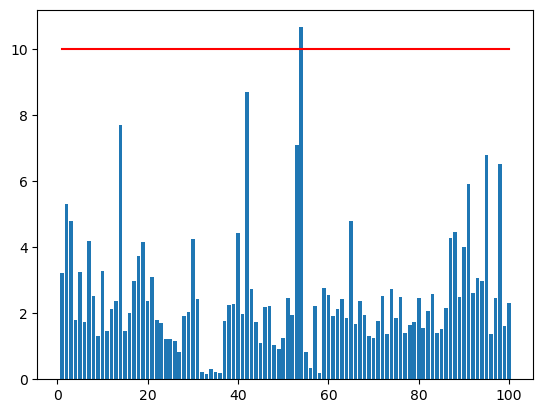

In [17]:
no_df = pd.DataFrame({'score':smape_list})
plt.bar(np.arange(len(no_df))+1, no_df['score'])
plt.plot([1,100], [10, 10], color = 'red')

## 4. test inference

### preprocessing for test data

#### train set과 동일한 전처리 과정

In [26]:
test = pd.read_csv('C:/Users/User/Desktop/Song/전력사용량 예측 공모전/data/test.csv')

In [28]:
cols = ['num_date_time','num', 'date_time', 'temp', 'prec','wind' ,'hum']
test.columns = cols

In [29]:
test.head()

,num_date_time,num,date_time,temp,prec,wind,hum
0,1_20220825 00,1,20220825 00,23.5,0.0,2.2,72
1,1_20220825 01,1,20220825 01,23.0,0.0,0.9,72
2,1_20220825 02,1,20220825 02,22.7,0.0,1.5,75
3,1_20220825 03,1,20220825 03,22.1,0.0,1.3,78
4,1_20220825 04,1,20220825 04,21.8,0.0,1.0,77


In [30]:
test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 16800 entries, 0 to 16799
Data columns (total 7 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   num_date_time  16800 non-null  object 
 1   num            16800 non-null  int64  
 2   date_time      16800 non-null  object 
 3   temp           16800 non-null  float64
 4   prec           16800 non-null  float64
 5   wind           16800 non-null  float64
 6   hum            16800 non-null  int64  
dtypes: float64(3), int64(2), object(2)
memory usage: 918.9+ KB


In [32]:
test.isnull().sum()

num_date_time    0
num              0
date_time        0
temp             0
prec             0
wind             0
hum              0
dtype: int64

In [33]:
test['date_time'] = pd.to_datetime(test['date_time'], format='%Y%m%d %H')
test['date_time']

0       2022-08-25 00:00:00
1       2022-08-25 01:00:00
2       2022-08-25 02:00:00
3       2022-08-25 03:00:00
4       2022-08-25 04:00:00
                ...        
16795   2022-08-31 19:00:00
16796   2022-08-31 20:00:00
16797   2022-08-31 21:00:00
16798   2022-08-31 22:00:00
16799   2022-08-31 23:00:00
Name: date_time, Length: 16800, dtype: datetime64[ns]

In [34]:
date = pd.to_datetime(test.date_time)
test['hour'] = date.dt.hour
test['day'] = date.dt.weekday
test['month'] = date.dt.month
test['week'] = date.dt.weekofyear

C:\Users\User\AppData\Local\Temp\ipykernel_33572\1069453073.py:5: FutureWarning: Series.dt.weekofyear and Series.dt.week have been deprecated. Please use Series.dt.isocalendar().week instead.
  test['week'] = date.dt.weekofyear


In [49]:
train_df = pd.read_csv('C:/Users/User/Desktop/Song/전력사용량 예측 공모전/data/train.csv', index_col = False)
## 변수 영문명으로 변경
cols = ['num_date_time','num', 'date_time', 'temp', 'prec','wind' ,'hum', 'hr', 'mj/m2', 'power']
train_df.columns = cols
# 강수량 결측치 0.0으로 채우기
train_df['prec'].fillna(0.0, inplace=True)
# pandas 내 선형보간 method 사용 wind, hum 열에 적용
for i in range(100):
    train_df.iloc[i*2040:(i+1)*2040, 5:7]  = train_df.iloc[i*2040:(i+1)*2040, 5:7].interpolate()
# train.csv 에만 있는 열 제거 num_date_time, hr, mj/m2
train_df = train_df.drop(['num_date_time','hr','mj/m2'], axis=1)
train_df.head()
# 시간 관련 변수들 생성
date = pd.to_datetime(train_df.date_time)
train_df['hour'] = date.dt.hour
train_df['day'] = date.dt.weekday
train_df['month'] = date.dt.month
train_df['week'] = date.dt.weekofyear
train_df.head()

C:\Users\User\AppData\Local\Temp\ipykernel_33572\2750094622.py:17: FutureWarning: Series.dt.weekofyear and Series.dt.week have been deprecated. Please use Series.dt.isocalendar().week instead.
  train_df['week'] = date.dt.weekofyear


,num,date_time,temp,prec,wind,hum,power,hour,day,month,week
0,1,20220601 00,18.6,0.0,0.9,42.0,1085.28,0,2,6,22
1,1,20220601 01,18.0,0.0,1.1,45.0,1047.36,1,2,6,22
2,1,20220601 02,17.7,0.0,1.5,45.0,974.88,2,2,6,22
3,1,20220601 03,16.7,0.0,1.4,48.0,953.76,3,2,6,22
4,1,20220601 04,18.4,0.0,2.8,43.0,986.40,4,2,6,22


In [50]:
## 건물별, 요일별, 시간별 발전량 평균 넣어주기
power_mean = pd.pivot_table(train_df, values = 'power', index = ['num', 'hour', 'day'], aggfunc = np.mean).reset_index()
tqdm.pandas()
test['day_hour_mean'] = test.progress_apply(lambda x : power_mean.loc[(power_mean.num == x['num']) & (power_mean.day == x['day']) & (power_mean.hour == x['hour']) ,'power'].values[0], axis = 1)

## 건물별 시간별 발전량 평균 넣어주기
power_hour_mean = pd.pivot_table(train_df, values = 'power', index = ['num', 'hour'], aggfunc = np.mean).reset_index()
tqdm.pandas()
test['hour_mean'] = test.progress_apply(lambda x : power_hour_mean.loc[(power_hour_mean.num == x['num']) & (power_hour_mean.hour == x['hour']) ,'power'].values[0], axis = 1)

## 건물별 시간별 발전량 표준편차 넣어주기
power_hour_std = pd.pivot_table(train_df, values = 'power', index = ['num', 'hour'], aggfunc = np.std).reset_index()
tqdm.pandas()
test['hour_std'] = test.progress_apply(lambda x : power_hour_std.loc[(power_hour_std.num == x['num']) & (power_hour_std.hour == x['hour']) ,'power'].values[0], axis = 1)

  0%|          | 0/16800 [00:00<?, ?it/s]

100%|██████████| 16800/16800 [00:18<00:00, 927.87it/s] 


In [51]:
test['holiday'] = test.apply(lambda x : 0 if x['day']<5 else 1, axis = 1)

In [ ]:
test['sin_time'] = np.sin(2*np.pi*test.hour/24)
test['cos_time'] = np.cos(2*np.pi*test.hour/24)

In [52]:
test['THI'] = 9/5*test['temp'] - 0.55*(1-test['hum']/100)*(9/5*test['hum']-26)+32

In [57]:
def CDH(xs):
    ys = []
    for i in range(len(xs)):
        if i < 11:
            ys.append(np.sum(xs[:(i+1)]-26))
        else:
            ys.append(np.sum(xs[(i-11):(i+1)]-26))
    return np.array(ys)

cdhs = np.array([])
for num in range(1,101,1):
    temp = test[test['num'] == num]
    cdh = CDH(temp['temp'].values)
    cdhs = np.concatenate([cdhs, cdh])
test['CDH'] = cdhs

In [61]:
test.drop(['num_date_time','hour','date_time'], axis = 1, inplace = True)

In [62]:
test.head()

,num,temp,prec,wind,hum,day,month,week,day_hour_mean,hour_mean,hour_std,holiday,THI,CDH,sin_time,cos_time
0,1,23.5,0.0,2.2,72,3,8,34,1627.80,1706.318118,446.882767,0,58.3456,-2.5,0.000000,1.000000
1,1,23.0,0.0,0.9,72,3,8,34,1550.08,1622.620235,439.662704,0,57.4456,-5.5,0.258819,0.965926
2,1,22.7,0.0,1.5,75,3,8,34,1431.12,1506.971294,412.071906,0,57.8725,-8.8,0.500000,0.866025
3,1,22.1,0.0,1.3,78,3,8,34,1372.20,1437.365647,391.205981,0,57.9376,-12.7,0.707107,0.707107
4,1,21.8,0.0,1.0,77,3,8,34,1381.72,1447.321412,381.099697,0,56.9961,-16.9,0.866025,0.500000


In [66]:
test = test[['num','temp', 'wind', 'hum', 'prec', 'day', 'month', 'week',
       'day_hour_mean', 'hour_mean', 'hour_std', 'holiday', 'sin_time',
       'cos_time', 'THI', 'CDH']]
test.head()

,num,temp,wind,hum,prec,day,month,week,day_hour_mean,hour_mean,hour_std,holiday,sin_time,cos_time,THI,CDH
0,1,23.5,2.2,72,0.0,3,8,34,1627.80,1706.318118,446.882767,0,0.000000,1.000000,58.3456,-2.5
1,1,23.0,0.9,72,0.0,3,8,34,1550.08,1622.620235,439.662704,0,0.258819,0.965926,57.4456,-5.5
2,1,22.7,1.5,75,0.0,3,8,34,1431.12,1506.971294,412.071906,0,0.500000,0.866025,57.8725,-8.8
3,1,22.1,1.3,78,0.0,3,8,34,1372.20,1437.365647,391.205981,0,0.707107,0.707107,57.9376,-12.7
4,1,21.8,1.0,77,0.0,3,8,34,1381.72,1447.321412,381.099697,0,0.866025,0.500000,56.9961,-16.9


In [67]:
xgb_params['alpha'] = alpha_list
xgb_params['best_it'] = best_it
xgb_params.head()

,n_estimators,eta,min_child_weight,max_depth,colsample_bytree,subsample,alpha,best_it
0,100,0.01,7,3,0.8,0.8,1,347
1,100,0.01,7,3,0.9,0.8,10,246
2,100,0.01,6,3,0.9,0.8,100,202
3,100,0.01,4,4,0.8,0.9,1,304
4,100,0.01,7,3,0.8,0.9,7,373


In [ ]:
test = pd.read_csv('C:/Users/User/Desktop/Song/전력사용량 예측 공모전/data/test.csv')

In [70]:
xgb_params.to_csv('C:/Users/User/Desktop/Song/전력사용량 예측 공모전/data/processing/hyperparameter_xgb_final.csv', index=False)

In [71]:
## best hyperparameters 불러오기
xgb_params = pd.read_csv('C:/Users/User/Desktop/Song/전력사용량 예측 공모전/data/processing/hyperparameter_xgb_final.csv')
xgb_params.head()

,n_estimators,eta,min_child_weight,max_depth,colsample_bytree,subsample,alpha,best_it
0,100,0.01,7,3,0.8,0.8,1,347
1,100,0.01,7,3,0.9,0.8,10,246
2,100,0.01,6,3,0.9,0.8,100,202
3,100,0.01,4,4,0.8,0.9,1,304
4,100,0.01,7,3,0.8,0.9,7,373


### 예측

In [75]:
test.head()

,num,temp,wind,hum,prec,day,month,week,day_hour_mean,hour_mean,hour_std,holiday,sin_time,cos_time,THI,CDH
0,1,23.5,2.2,72,0.0,3,8,34,1627.80,1706.318118,446.882767,0,0.000000,1.000000,58.3456,-2.5
1,1,23.0,0.9,72,0.0,3,8,34,1550.08,1622.620235,439.662704,0,0.258819,0.965926,57.4456,-5.5
2,1,22.7,1.5,75,0.0,3,8,34,1431.12,1506.971294,412.071906,0,0.500000,0.866025,57.8725,-8.8
3,1,22.1,1.3,78,0.0,3,8,34,1372.20,1437.365647,391.205981,0,0.707107,0.707107,57.9376,-12.7
4,1,21.8,1.0,77,0.0,3,8,34,1381.72,1447.321412,381.099697,0,0.866025,0.500000,56.9961,-16.9


In [76]:
train.head()

,num,date_time,power,prec,wind,hum,temp,day,month,week,day_hour_mean,hour_mean,hour_std,holiday,sin_time,cos_time,THI,CDH
0,1,20220601 00,1085.28,0.0,0.9,42.0,18.6,2,6,22,1774.744615,1706.318118,446.882767,0,0.000000,1.000000,49.6576,-7.4
1,1,20220601 01,1047.36,0.0,1.1,45.0,18.0,2,6,22,1687.347692,1622.620235,439.662704,0,0.258819,0.965926,47.7625,-15.4
2,1,20220601 02,974.88,0.0,1.5,45.0,17.7,2,6,22,1571.483077,1506.971294,412.071906,0,0.500000,0.866025,47.2225,-23.7
3,1,20220601 03,953.76,0.0,1.4,48.0,16.7,2,6,22,1522.153846,1437.365647,391.205981,0,0.707107,0.707107,44.7856,-33.0
4,1,20220601 04,986.40,0.0,2.8,43.0,18.4,2,6,22,1506.793846,1447.321412,381.099697,0,0.866025,0.500000,49.0061,-40.6


In [77]:
preds = np.array([]) 
for i in tqdm(range(100)):
    
    pred_df = pd.DataFrame()   # 시드별 예측값을 담을 data frame
    
    # for seed in [0,1,2,3,4,5]: # 각 시드별 예측
    y_train = train.loc[train.num == i+1, 'power']
    x_train, x_test = train.loc[train.num == i+1, ].iloc[:, 3:], test.loc[test.num == i+1, ].iloc[:,1:]
    x_test = x_test[x_train.columns]
    
    xgb = XGBRegressor(seed = 42, n_estimators = best_it[i], eta = 0.01, 
                        min_child_weight = xgb_params.iloc[i, 2], max_depth = xgb_params.iloc[i, 3], 
                        colsample_bytree=xgb_params.iloc[i, 4], subsample=xgb_params.iloc[i, 5])

    if xgb_params.iloc[i,6] != 0:  # 만약 alpha가 0이 아니면 weighted_mse 사용
        xgb.set_params(**{'objective':weighted_mse(xgb_params.iloc[i,6])})
    
    xgb.fit(x_train, y_train)
    y_pred = xgb.predict(x_test)
    # pred_df.loc[:,seed] = y_pred   # 각 시드별 예측 담기
    # pred = pred_df.mean(axis=1)        # (i+1)번째 건물의 예측 =  (i+1)번째 건물의 각 시드별 예측 평균값
    preds = np.append(preds, y_pred)   

  0%|          | 0/100 [00:00<?, ?it/s]c:\Users\User\anaconda3\lib\site-packages\xgboost\data.py:173: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  from pandas import MultiIndex, Int64Index
  1%|          | 1/100 [00:00<01:01,  1.61it/s]c:\Users\User\anaconda3\lib\site-packages\xgboost\data.py:173: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  from pandas import MultiIndex, Int64Index
  2%|▏         | 2/100 [00:01<00:51,  1.92it/s]c:\Users\User\anaconda3\lib\site-packages\xgboost\data.py:173: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  from pandas import MultiIndex, Int64Index
  3%|▎         | 3/100 [00:01<00:42,  2.26it/s]c:\Users\User\anaconda3\lib\site-package

In [78]:
preds = pd.Series(preds)

fig, ax = plt.subplots(100, 1, figsize=(100,200), sharex = True)
ax = ax.flatten()
for i in range(100):
    train_y = train.loc[train.num == i+1, 'power'].reset_index(drop = True)
    test_y = preds[i*168:(i+1)*168]
    ax[i].scatter(np.arange(2040) , train.loc[train.num == i+1, 'power'])
    ax[i].scatter(np.arange(2040, 2040+168) , test_y)
    ax[i].tick_params(axis='both', which='major', labelsize=6)
    ax[i].tick_params(axis='both', which='minor', labelsize=4)
#plt.savefig('./predict_xgb.png')
plt.show()

In [79]:
submission = pd.read_csv('C:/Users/User/Desktop/Song/전력사용량 예측 공모전/data/sample_submission.csv')
submission['answer'] = preds
submission.to_csv('C:/Users/User/Desktop/Song/전력사용량 예측 공모전/data/processing/submission_xgb_noclip.csv', index = False)

## 5. post processing

#### weighted mse와 같은 맥락에서, 과도한 underestimate를 막기 위해 예측값을 후처리했습니다.
##### - 예측 주로부터 직전 4주(train set 마지막 28일)의 건물별 요일별 시간대별 전력소비량의 최솟값을 구한 뒤, 
##### - test set의 같은 건물 요일 시간대의 예측값과 비교하여 만약 1번의 최솟값보다 예측값이 작다면 최솟값으로 예측값을 대체해주었습니다.
##### - public score 0.01 , private score 0.08 정도의 성능 향상이 있었습니다.

In [81]:
train_df = pd.read_csv('C:/Users/User/Desktop/Song/전력사용량 예측 공모전/data/train.csv', index_col = False)
cols = ['num_date_time','num', 'date_time', 'temp', 'prec','wind' ,'hum', 'hr', 'mj/m2', 'power']
train_df.columns = cols
train_df['prec'].fillna(0.0, inplace=True)
for i in range(100):
    train_df.iloc[i*2040:(i+1)*2040, 5:7]  = train_df.iloc[i*2040:(i+1)*2040, 5:7].interpolate()
train_df = train_df.drop(['num_date_time','hr','mj/m2'], axis=1)
train_df.head()
date = pd.to_datetime(train_df.date_time)
train_df['hour'] = date.dt.hour
train_df['day'] = date.dt.weekday
train_df['month'] = date.dt.month
train_df['week'] = date.dt.weekofyear
train_df.head()

pred_clip = []
test = pd.read_csv('C:/Users/User/Desktop/Song/전력사용량 예측 공모전/data/test.csv')
cols = ['num_date_time','num', 'date_time', 'temp', 'prec','wind' ,'hum']
test.columns = cols
test['date_time'] = pd.to_datetime(test['date_time'], format='%Y%m%d %H')
test['date_time']
date = pd.to_datetime(test.date_time)
test['hour'] = date.dt.hour
test['day'] = date.dt.weekday
test['month'] = date.dt.month
test['week'] = date.dt.weekofyear

## submission 불러오기
df = pd.read_csv('C:/Users/User/Desktop/Song/전력사용량 예측 공모전/data/processing/submission_xgb_noclip.csv')
for i in range(100):
    min_data = train_df.loc[train_df.num == i+1, ].iloc[-28*24:, :] ## 건물별로 직전 28일의 데이터 불러오기
    ## 요일별, 시간대별 최솟값 계산
    min_data = pd.pivot_table(min_data, values = 'power', index = ['day', 'hour'], aggfunc = min).reset_index() 
    pred = df.answer[168*i:168*(i+1)].reset_index(drop=True) ## 168개 데이터, 즉 건물별 예측값 불러오기
    day =  test.day[168*i:168*(i+1)].reset_index(drop=True) ## 예측값 요일 불러오기
    hour = test.hour[168*i:168*(i+1)].reset_index(drop=True) ## 예측값 시간 불러오기
    df_pred = pd.concat([pred, day, hour], axis = 1)
    df_pred.columns = ['pred', 'day', 'hour']
    for j in range(len(df_pred)):
        min_power = min_data.loc[(min_data.day == df_pred.day[j])&(min_data.hour == df_pred.hour[j]), 'power'].values[0]
        if df_pred.pred[j] < min_power:
            pred_clip.append(min_power)
        else:
            pred_clip.append(df_pred.pred[j])

C:\Users\User\AppData\Local\Temp\ipykernel_33572\550552128.py:13: FutureWarning: Series.dt.weekofyear and Series.dt.week have been deprecated. Please use Series.dt.isocalendar().week instead.
  train_df['week'] = date.dt.weekofyear
C:\Users\User\AppData\Local\Temp\ipykernel_33572\550552128.py:26: FutureWarning: Series.dt.weekofyear and Series.dt.week have been deprecated. Please use Series.dt.isocalendar().week instead.
  test['week'] = date.dt.weekofyear


c:\Users\User\anaconda3\lib\site-packages\sktime\utils\plotting.py:112: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(1, figsize=plt.figaspect(0.25))


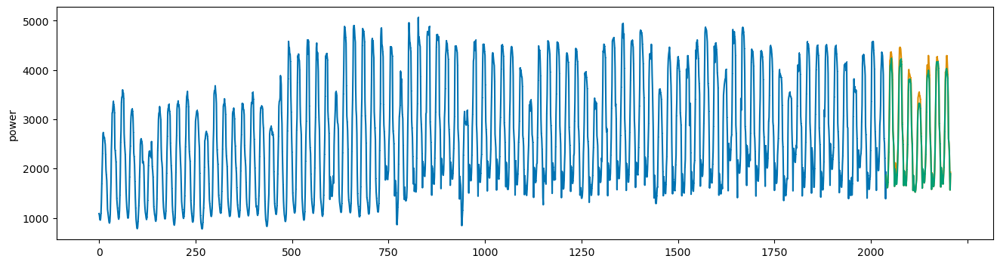

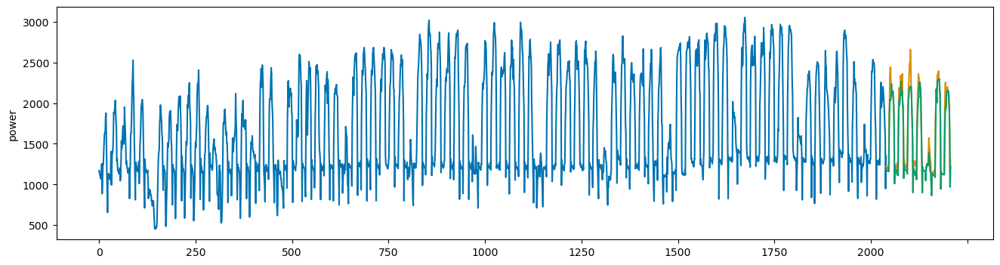

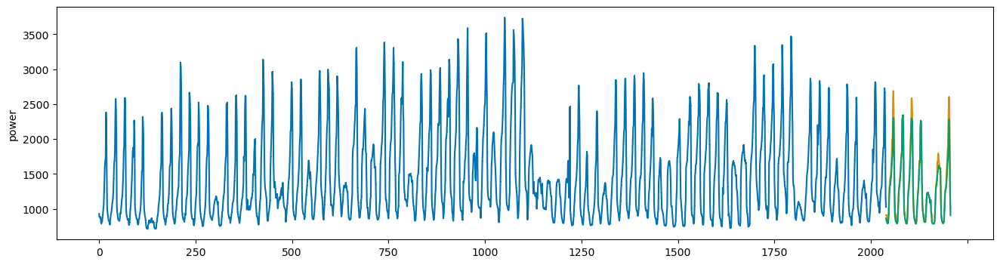

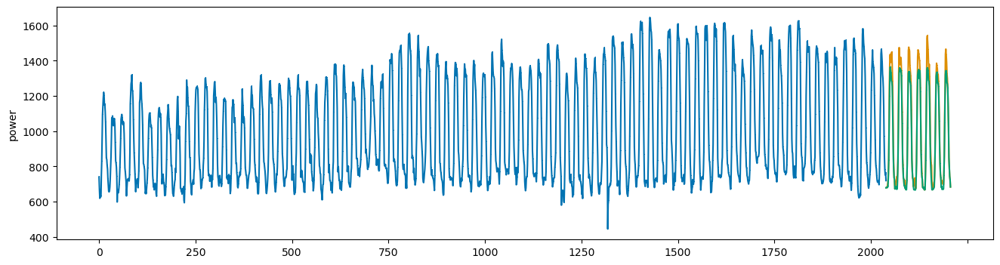

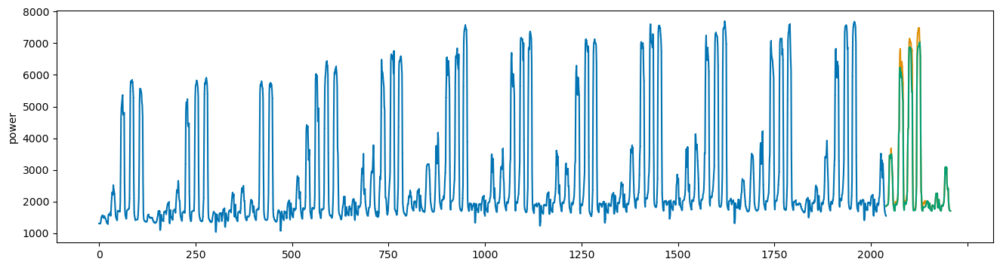

...

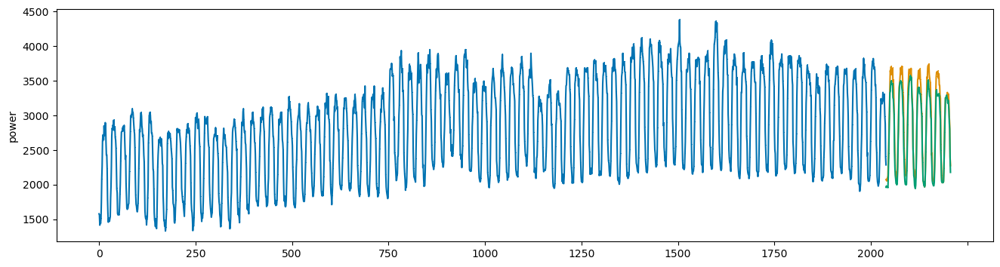

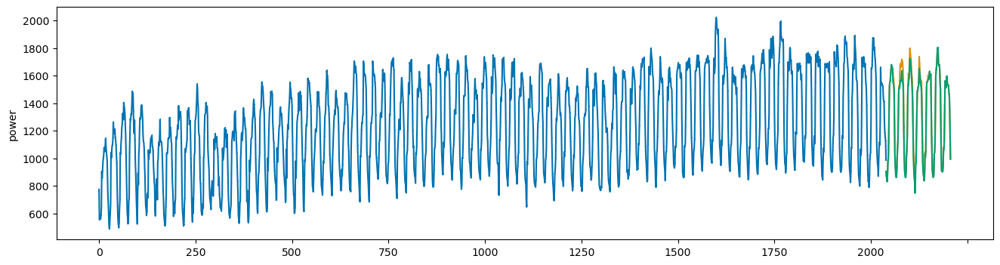

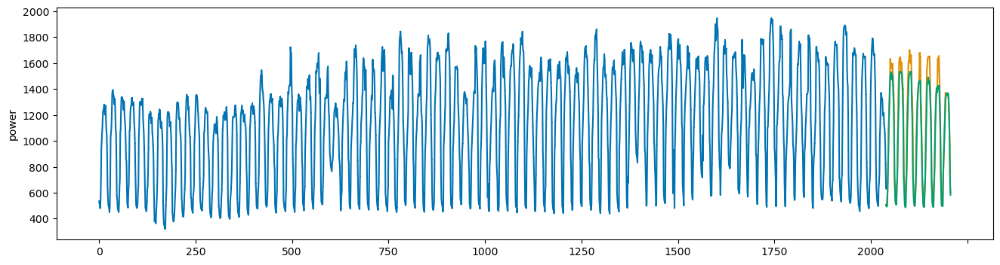

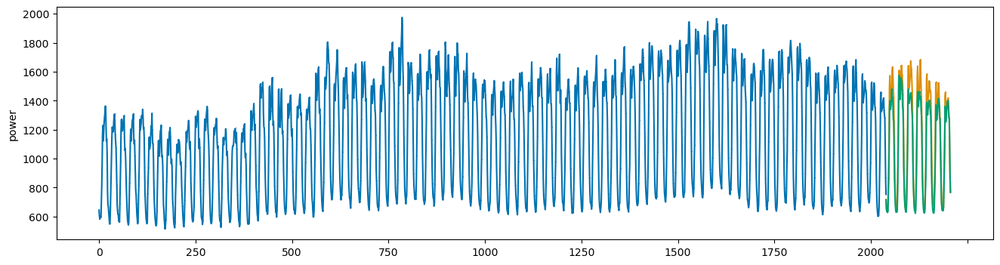

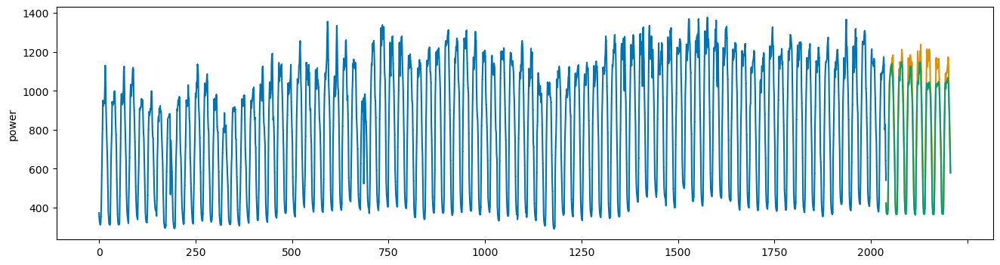

In [83]:
pred_origin = df.answer
pred_clip = pd.Series(pred_clip)

for i in range(100):
    power = train_df.loc[train_df.num == i+1, 'power'].reset_index(drop=True)
    preds = pred_clip[i*168:(i+1)*168]
    preds_origin = pred_origin[i*168:(i+1)*168]
    preds.index = range(power.index[-1], power.index[-1]+168)
    preds_origin.index = range(power.index[-1], power.index[-1]+168)
    
    plot_series(power, preds,  preds_origin, markers = [',', ',', ','])

In [84]:
submission = pd.read_csv('C:/Users/User/Desktop/Song/전력사용량 예측 공모전/data/sample_submission.csv')
submission['answer'] = pred_clip
submission.to_csv('C:/Users/User/Desktop/Song/전력사용량 예측 공모전/data/processing/submission_xgb_final.csv', index = False)